# Lending Club Case Study

**Problem Statement**

>Need to identify the driving factors/variables for Loan default based on the provided data set

**Approach**
- **Data Understanding** - Getting insight on the dataset provided and its variables along with the nature of data
- **Data Cleaning** - Data that cannot be utilized to be cleaned by removing null columns and rows that can be removed safely.
- **Data Handling** - Data type conversion and changing the values to usable form
- **Data Analysis** - Performing Univariate, Bivariate and Multivariate analysis
- **Recommendation** - Based on the analysis recommendations to reduce Loan default to be suggested

In [1]:
import pandas as pd
import numpy as np

In [2]:
df=pd.read_csv("loan.csv",low_memory=False)

## Data Understanding

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


In [4]:
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [5]:
df.shape

(39717, 111)

**Observation:**
- 111 Columns are present
- 39717 Rows are present
- Many columns are having NaN as value that means cleaning is needed
- Columns such as int_rate need to be coverted to proper data type

## Data Cleaning

---
### Step1 - Remove Null Columns

In [6]:
df.dropna(how='all', axis=1, inplace=True)

In [7]:
df.shape

(39717, 57)

#### Step1 - Completed 
Observation:
57 columns are remaining
---

### Step2 - Drop columns that are not meaningful for analysis
Criteria for Dropping columns as below.
1. Any column that has the same value throught all rows can be dropped since it does not add value
2. Any column that does not provide any insight that is related to loan default analysis
3. Dropping behavioural columns since loan is already approved and analysis is to profile the granted loan.

In [8]:
for column in df.columns:
    if(df[column].unique().size==1):
        print(column,",",df[column].unique()[0])

pymnt_plan , n
initial_list_status , f
policy_code , 1
application_type , INDIVIDUAL
acc_now_delinq , 0
delinq_amnt , 0


Columns to be removed based on above criteria.
1. pymnt_plan - Has value as n for all rows. *Removal Criteria 1*
2. url - does not add any value for current analysis. *Removal Criteria 2*
3. initial_list_status - Has value as f for all rows. *Removal Criteria 1*
4. application_type - Has value as INDIVIDUAL for all rows. *Removal Criteria 1*
5. policy_code - Has value as 1 for all rows. *Removal Criteria 1*
6. acc_now_delinq - Has value as 0 for all rows. *Removal Criteria 1*
7. delinq_amnt - Has value as 0 for all rows. *Removal Criteria 1*
8. emp_title - Tile has undergone certain changes on 2013 and that makes the column unusable. *Removal Criteria 2*
9. tax_liens - All the values available are 0 and there are missing records hence unusable. *Removal Criteria 1*
10. title - title provided by the borrower. data is not usable and has many junk values. *Removal Criteria 2*
11. desc - desc provided by the borrower. data has many null values and not usable. *Removal Criteria 2*
12. delinq_2yrs - If deliquent in last 2 year. Behaviour column. *Removal Criteria 3*
13. earliest_cr_line - Behaviour column. *Removal Criteria 3*
14. inq_last_6mths - Behaviour column. *Removal Criteria 3*
15. open_acc - Behaviour column. *Removal Criteria 3*
16. pub_rec - Behaviour column. *Removal Criteria 3*
17. revol_bal - Behaviour column. *Removal Criteria 3*
18. revol_util - Behaviour column. *Removal Criteria 3*
19. total_acc - Behaviour column. *Removal Criteria 3*
20. out_prncp - Behaviour column. *Removal Criteria 3*
21. out_prncp_inv - Behaviour column. *Removal Criteria 3*
22. total_pymnt - Behaviour column. *Removal Criteria 3*
23. total_pymnt_inv - Behaviour column. *Removal Criteria 3*
24. total_rec_prncp - Behaviour column. *Removal Criteria 3*
25. total_rec_int - Behaviour column. *Removal Criteria 3*
26. total_rec_late_fee - Behaviour column. *Removal Criteria 3*
27. recoveries - Behaviour column. *Removal Criteria 3*
28. collection_recovery_fee - Behaviour column. *Removal Criteria 3*
29. last_pymnt_d - Behaviour column. *Removal Criteria 3*
30. last_pymnt_amnt - Behaviour column. *Removal Criteria 3*
31. last_credit_pull_d - Behaviour column. *Removal Criteria 3*
32. id - not providing any insight. *Removal Criteria 1*
32. member_id - not providing any insight. *Removal Criteria 1*

In [9]:
df.drop(['id','member_id','delinq_2yrs','earliest_cr_line','inq_last_6mths','open_acc','pub_rec','revol_bal','revol_util','total_acc','out_prncp','out_prncp_inv','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','total_rec_late_fee','recoveries','collection_recovery_fee','last_pymnt_d','last_pymnt_amnt','last_credit_pull_d','desc','title','tax_liens','emp_title','pymnt_plan','url','initial_list_status','application_type','policy_code','acc_now_delinq','delinq_amnt'],axis=1, inplace=True)

In [10]:
df.shape

(39717, 24)

#### Step2 Completed.
Observation:
24 Columns are remaining.
---

### Step3 - Check for missing values

In [11]:
df.isnull().sum()

loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
term                              0
int_rate                          0
installment                       0
grade                             0
sub_grade                         0
emp_length                     1075
home_ownership                    0
annual_inc                        0
verification_status               0
issue_d                           0
loan_status                       0
purpose                           0
zip_code                          0
addr_state                        0
dti                               0
mths_since_last_delinq        25682
mths_since_last_record        36931
next_pymnt_d                  38577
collections_12_mths_ex_med       56
chargeoff_within_12_mths         56
pub_rec_bankruptcies            697
dtype: int64

#### Dropping columns that has maximum null values and having more than 70% as null records

In [12]:
df.drop(['pub_rec_bankruptcies','next_pymnt_d','mths_since_last_delinq','mths_since_last_record'],axis=1, inplace=True)

#### Removing data that contain null values and are less in number of removals also imputing data will not be productive

In [13]:
#emp_length null values cannot be imputed since it will impact the analysis hence removing is the safest approach
df.emp_length.fillna('None',inplace=True)
#collections_12_mths_ex_med has values 0 or NA which does not provide any valuable insight hece to be removed
df.drop(['collections_12_mths_ex_med'],axis=1, inplace=True)
#chargeoff_within_12_mths has values 0 or NA which does not provide any valuable insight hece to be removed
df.drop(['chargeoff_within_12_mths'],axis=1, inplace=True)
#df=df[df.pub_rec_bankruptcies.notna()]

In [14]:
df.isnull().sum()

loan_amnt              0
funded_amnt            0
funded_amnt_inv        0
term                   0
int_rate               0
installment            0
grade                  0
sub_grade              0
emp_length             0
home_ownership         0
annual_inc             0
verification_status    0
issue_d                0
loan_status            0
purpose                0
zip_code               0
addr_state             0
dti                    0
dtype: int64

#### Step3 is completed.
Observation:
All missing values are addressed appropriately.

---

### Step4 - Handling incorrect data types

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   loan_amnt            39717 non-null  int64  
 1   funded_amnt          39717 non-null  int64  
 2   funded_amnt_inv      39717 non-null  float64
 3   term                 39717 non-null  object 
 4   int_rate             39717 non-null  object 
 5   installment          39717 non-null  float64
 6   grade                39717 non-null  object 
 7   sub_grade            39717 non-null  object 
 8   emp_length           39717 non-null  object 
 9   home_ownership       39717 non-null  object 
 10  annual_inc           39717 non-null  float64
 11  verification_status  39717 non-null  object 
 12  issue_d              39717 non-null  object 
 13  loan_status          39717 non-null  object 
 14  purpose              39717 non-null  object 
 15  zip_code             39717 non-null 

#### Below list of columns to be fixed
1. Fixing emp_length by creating new column emp_length_year values ranging (0 to 10)
2. int_rate to be converted as float
3. issue_d issue date to be converted as date column by creating new column issue_date eventhough date is missing we are assuming 01 as date to covert it to a date format
4. term can be converted to int by striping months
5. verification_status can be converted to binary since Verified and Source Verified denote the same. 0 will be Not Verified and 1 will be Verified and Source Verified. 

In [16]:
df['emp_length']=df['emp_length'].apply(
    lambda x: x if(x!='< 1 year' and x!='None') else '0.5' if(x=='None') else '0'
)
df['emp_length_year']=pd.to_numeric(df.emp_length.str.replace(r"[^0-9.]",'',regex=True))
df['emp_length_year'].value_counts()
df['emp_length_cat']=df['emp_length_year'].apply(
    lambda x: 'No Info' if(x==0) else 'Junior' if(x>0 and x<4) else 'Mid Level' if(x>=4 and x<9) else 'Senior'
)
df['emp_length_cat'].value_counts()

Junior       12798
Mid Level    12199
Senior       10137
No Info       4583
Name: emp_length_cat, dtype: int64

In [17]:
df['int_rate']=pd.to_numeric(df.int_rate.str.replace("%",''))

In [18]:
import locale
curr = locale.getdefaultlocale()
df['issue_date']=pd.to_datetime(df.issue_d.apply(lambda x:"01-"+x))
df['issue_month']=df['issue_date'].dt.month_name(locale=curr)
df['issue_year']=df['issue_date'].dt.year

In [19]:
df['term']=pd.to_numeric(df.term.str.replace(" months",''))

In [20]:
#creacting verification_status_b column to have binary value of verification
df['verification_status_b']=df.verification_status.apply(lambda x:0 if(x=='Not Verified') else 1)

In [21]:
#cleaning NONE category which has just 3 values in dataset since with very limited category data analysis will be impacted
df=df[df.home_ownership!='NONE']

#### Source columns of coverted columns can be safely removed now

In [22]:
df.drop(['emp_length','issue_d'],axis=1, inplace=True)

In [23]:
df.shape

(39714, 22)

#### Step4 is completed
Observation:
Data types are converted and handled appropriately.
---

### Step5 Cleaning target variable
Selecting data that will be used for analysis. Current loan will not provide any insight so excluding it from the data set

In [24]:
df=df[((df.loan_status=='Charged Off') | (df.loan_status=='Fully Paid'))]
df['loan_status']=df.loan_status.apply(lambda x:0 if(x=='Charged Off') else 1)
df.shape

(38574, 22)

In [25]:
df.loan_status.value_counts()

1    32947
0     5627
Name: loan_status, dtype: int64

#### Step5 is completed
Observation:
36735 records remaining.

### Step6 Cleaning Outliers

#### Checking Annual Income

In [26]:
#Checking the annual income
import matplotlib.pyplot as plt
df.annual_inc.describe()

count    3.857400e+04
mean     6.877704e+04
std      6.422001e+04
min      4.000000e+03
25%      4.000000e+04
50%      5.886028e+04
75%      8.200000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64

count    3.857400e+04
mean     6.877704e+04
std      6.422001e+04
min      4.000000e+03
25%      4.000000e+04
50%      5.886028e+04
75%      8.200000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64


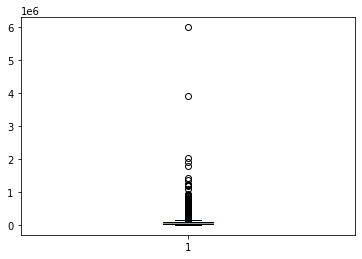

In [27]:
plt_data=df[df.annual_inc>0]['annual_inc']
plt.boxplot(plt_data)
print(plt_data.describe())
plt.show()

**Observation:**
- Plot itself not visible due to high value of the outliers
- Top outlier is visible above 600k and the next one visible above 350k
- Can consider values above 350k as outliers and remove them

count     38443.000000
mean      66706.743566
std       39039.757940
min        4000.000000
25%       40000.000000
50%       58296.000000
75%       81996.000000
max      348000.000000
Name: annual_inc, dtype: object


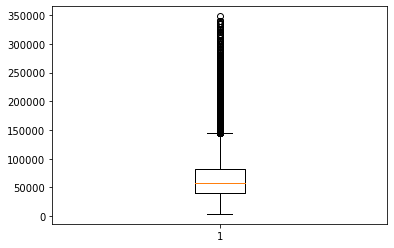

In [28]:
#removing annual income above 350K
df=df[df.annual_inc<350000]
plt_data=df[df.annual_inc>0]['annual_inc']
plt.boxplot(plt_data)
print(plt_data.describe().apply(lambda x: format(x, 'f')))
plt.show()

**Observation:**
- After cleaning the annual income above 350k box plot is visible with a median above 50k
- observing iqr should give more insights if cleaning is sufficient

In [29]:
#check iqr vs mean for annual
import numpy as np
q3, q1 = np.percentile(df.annual_inc, [75 ,25])
iqr = q3 - q1
print("iqr : ",iqr)
df.annual_inc.describe().apply(lambda x: format(x, 'f'))

iqr :  41996.0


count     38443.000000
mean      66706.743566
std       39039.757940
min        4000.000000
25%       40000.000000
50%       58296.000000
75%       81996.000000
max      348000.000000
Name: annual_inc, dtype: object

#### Checking Loan amount column

count    38443.000000
mean     11024.854980
std       7323.805869
min        500.000000
25%       5287.500000
50%       9600.000000
75%      15000.000000
max      35000.000000
Name: loan_amnt, dtype: float64


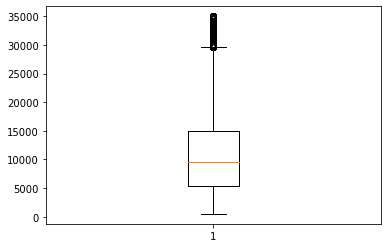

In [30]:
#checking outlier for loan amount
plt_data=df[df.loan_amnt>0]['loan_amnt']
plt.boxplot(plt_data)
print(plt_data.describe())
plt.show()

**Observation:**
- Box plot is visible with median value around 10000
- Outlier treatment not needed

count    38315.000000
mean     10238.019207
std       6985.406392
min          0.000121
25%       5000.000000
50%       8759.739035
75%      14000.000000
max      35000.000000
Name: funded_amnt_inv, dtype: float64


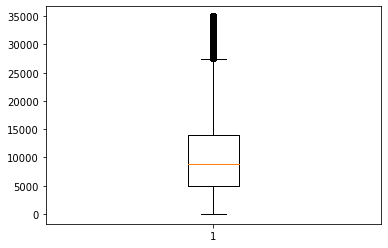

In [31]:
#checking outlier for funded_amnt_inv
plt_data=df[df.funded_amnt_inv>0]['funded_amnt_inv']
plt.boxplot(plt_data)
print(plt_data.describe())
plt.show()

#### Checking Loan Interest Rate

count    38443.000000
mean        11.929243
std          3.689663
min          5.420000
25%          8.940000
50%         11.710000
75%         14.350000
max         24.400000
Name: int_rate, dtype: float64


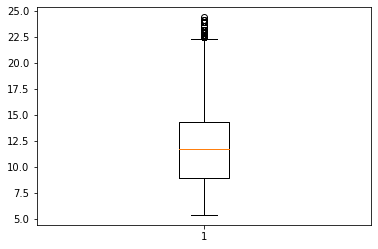

In [32]:
#checking outlier for loan interest
plt_data=df[df.loan_amnt>0]['int_rate']
plt.boxplot(plt_data)
print(plt_data.describe())
plt.show()

**Observation:**
- Box plot is visible with a median value arond 12 percent
- Outlier treatment is not needed

### Data Cleaning is Completed.
Observation:
Less than 2% of the original data set has to be cleaned so that analysis provides expected insights.
---

## Data Analysis


In [33]:
#import necessary libs
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import plotly.offline as py 
py.init_notebook_mode(connected=True) # this code, allow us to work with offline plotly version
import plotly.graph_objs as go # it's like "plt" of matplot
import plotly.tools as tls # It's useful to we get some tools of plotly
import warnings # This library will be used to ignore some warnings
from collections import Counter # To do counter of some features

In [34]:
plt.style.use('ggplot')

#### Creating a function that calculates the charge off aspects as below
- Function_name : find_percentage
- Usage : Returns % of charge-off for every unique value of a column(Categorical)
- Arguments : dataframe, column
- Returns : a dataframe containing unique values of a caterory, % of charge-off, % of charge-off contribution to total charge-off, % of Loan obtained, a binary value denoting 'Y' for % of charge-off contribution greater than % of Loan obtained



In [35]:
def find_percentage(df, col):
    new_df = pd.DataFrame(columns=['Value', '% of Charge-Off', '% Of Contribution', '% of Loan Obtained'])
    avg_chrg_off=round(df[df.loan_status==0].loan_status.count()*100/df.loan_status.count(),2)
    for value in df[col].unique():
        default_cnt = df[(df[col] == value) & (df.loan_status == 0)].shape[0]
        total_cnt = df[df[col] == value].shape[0]
        total_default_cnt = df[(df.loan_status == 0)].loan_status.count()
        total_loan_cnt = df.loan_status.count()
        new_df = new_df.append({'Value' : value , '% of Charge-Off' : (default_cnt*100/total_cnt), '% Of Contribution' : (total_cnt*100/total_loan_cnt), '% of Loan Obtained' : (default_cnt*100/total_default_cnt)}, ignore_index=True)
        new_df['Default to Loan Ratio'] = round(new_df['% Of Contribution']/new_df['% of Loan Obtained'],2)
        new_df['% Charge-Off > % Loan Obtained'] = np.where((new_df['% Of Contribution'] > new_df['% of Loan Obtained']), 'Y', 'N')
        new_df['% Charge-Off > Avg Charge Off'] = new_df['% of Charge-Off'].apply(lambda x:'Y' if(x>avg_chrg_off) else 'N')
        
    return new_df.sort_values(by='% of Charge-Off', ascending=False)

#### Creating categorical columns from numerical columns

In [36]:
#creating Loan Amount Category based on quantiles
small,med,high,vhigh=np.quantile(df.funded_amnt_inv,[0.25,0.5,0.75,1])
df['loan_amt_category']=df.funded_amnt_inv.apply(lambda x:'Small' if(x>0 and x<=small) else 'Medium' if(x>small and x<=med) else 'High' if(x>med and x<=high) else 'Very High')

In [37]:
#creating Income Category based on a research study
small,med,high=(32000,55000,100000)
df['income_category']=df.annual_inc.apply(lambda x:'Poor Income' if(x>0 and x<=small) else 'Low Income' if(x>small and x<=med) else 'Middle Income' if(x>med and x<=high) else 'Higher Income')

**Comment:** Income category is obtained from Georgia Washington University research.

- Reference - https://money.usnews.com/money/personal-finance/family-finance/articles/where-do-i-fall-in-the-american-economic-class-system

In [38]:
#creating Interest Category based on quantiles
small,med,high,vhigh=np.quantile(df.int_rate,[0.25,0.5,0.75,1])
df['interest_category']=df.int_rate.apply(lambda x:'Low' if(x>0 and x<=small) else 'Medium' if(x>small and x<=med) else 'High' if(x>med and x<=high) else 'Very High')

In [39]:
#Creating Funded Amount Category based on the distribution of loan granted
cat1,cat2,cat3,cat4,cat5,cat6,cat7=(5000,10000,15000,20000,25000,30000,35000)
df['funded_amnt_cat']=df.funded_amnt_inv.apply(lambda x:'5K' if(x>0 and x<=cat1) else '10K' if(x>cat1 and x<=cat2) else '15K' if(x>cat2 and x<=cat3) else '20K' if(x>cat3 and x<=cat4) else '25K' if(x>cat4 and x<=cat5) else '30K' if(x>cat5 and x<=cat6) else '35k')

In [40]:
#Creating subgrade category in numerical format
df['sub_grade_cat']=pd.to_numeric(df.sub_grade.str.replace(r"[^0-9]",'',regex=True))

#### Checking the spread of loan status

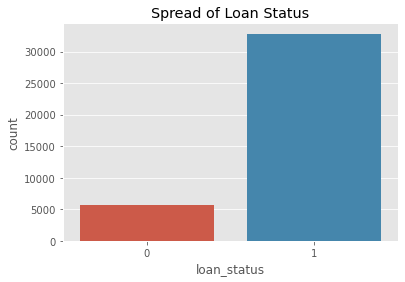

1    32834
0     5609
Name: loan_status, dtype: int64
85.41 % of Loans Fully Paid
14.59 % of Loans Charged-Off


In [41]:
plt.figure()
plt.title("Spread of Loan Status")
sns.countplot(x=df.loan_status)
plt.show()
loan_count=df.loan_status.value_counts()
df_default=df[df.loan_status==0]
df_paid=df[df.loan_status==1]
print(loan_count)
print(round(loan_count[1]*100/df.loan_status.count(),2), "% of Loans Fully Paid")
print(round(loan_count[0]*100/df.loan_status.count(),2), "% of Loans Charged-Off")



**Observation:**
- 85.4% of loans are fully paid
- 14.6% of loans are charged-off
- 14.6% can be considered as baseline for finding variables that impact loans adversely by contributing more than the overall charge-off percentage

#### Checking highly correlated columns

In [42]:
paid_corr = df[df.loan_status==1].corr()
round(paid_corr, 2)

corr_list = paid_corr.unstack()
print(corr_list.sort_values(ascending=False).drop_duplicates().head(11))

loan_amnt        loan_amnt          1.000000
funded_amnt      loan_amnt          0.982332
                 funded_amnt_inv    0.962502
                 installment        0.959399
funded_amnt_inv  loan_amnt          0.944737
loan_amnt        installment        0.934150
installment      funded_amnt_inv    0.914879
loan_amnt        annual_inc         0.415688
int_rate         term               0.411944
annual_inc       funded_amnt        0.411643
installment      annual_inc         0.411395
dtype: float64


In [43]:
charge_off_corr = df[df.loan_status==0].corr()
round(charge_off_corr, 2)

corr_list = charge_off_corr.unstack()
print(corr_list.sort_values(ascending=False).drop_duplicates().head(11))

loan_amnt        loan_amnt          1.000000
funded_amnt      loan_amnt          0.979069
                 installment        0.953804
                 funded_amnt_inv    0.927556
loan_amnt        installment        0.925856
                 funded_amnt_inv    0.907581
funded_amnt_inv  installment        0.858557
int_rate         term               0.456320
annual_inc       installment        0.448733
loan_amnt        annual_inc         0.448436
funded_amnt      annual_inc         0.439388
dtype: float64


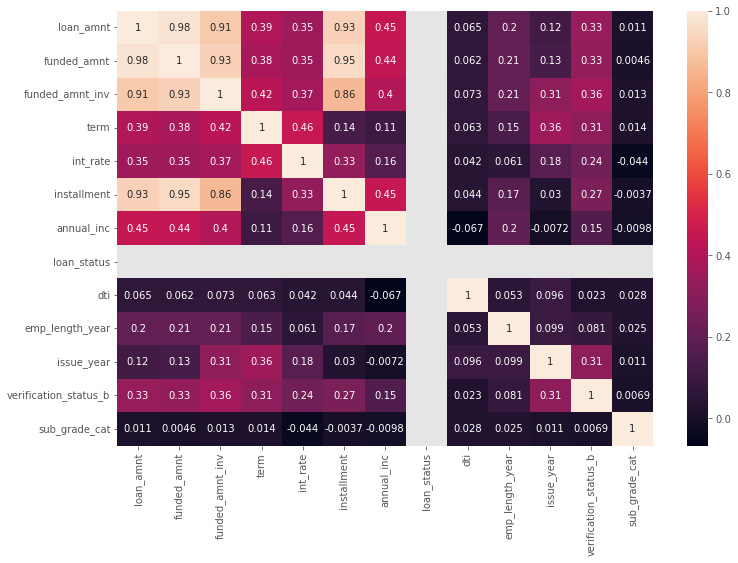

In [44]:
plt.figure(figsize=(12,8))
sns.heatmap(charge_off_corr, annot=True)
plt.show()

**Observation:**
- Loan Amount, Funded Amount and Funded by Investor are highly correlated.

## Univariate Analysis

### Checking Verification Status splitup

In [45]:
#labels
lab = df["verification_status"].value_counts().keys().tolist()
#values
val = df["verification_status"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'red' ,'lime','royalblue'],
                             line = dict(color = "white",
                                         width =  1)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Income Verification Status",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

**Observation:**
- Most loans are granted to borrowers whose income is not verified

### Checking Income Category

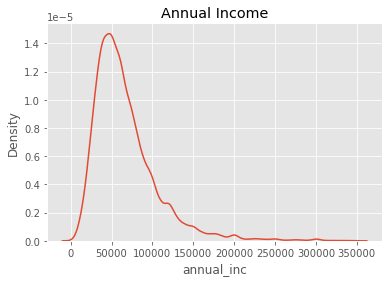

In [46]:
#labels
lab = df["income_category"].value_counts().keys().tolist()
#values
val = df["income_category"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'orange','lime','red'],
                             line = dict(color = "white",
                                         width =  1)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Income Category",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

plt.figure()
sns.kdeplot(data=df, x="annual_inc")
plt.title("Annual Income")
plt.show()

**Observation:**
- Most number of loans are granted to Middle Income group with annual income less than 50000
- Least number of loans are granted to Poor Income group

### Checking Employment Category
- No Info available for experience
- Junior - 0 to 3 years of experience
- Mid Level - 4 to 8 years of experience
- Senior - Above 9 years of experience

In [47]:
#labels
lab = df["emp_length_cat"].value_counts().keys().tolist()
#values
val = df["emp_length_cat"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'orange','lime','red'],
                             line = dict(color = "white",
                                         width =  1)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Employment Category",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

**Observation:**
- Most loans are obtained by Junior employees with less than 3 years of experience

### Checking Home Ownership

In [48]:
#labels
lab = df.home_ownership.value_counts().keys().tolist()
#values
val = df.home_ownership.value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'orange','lime','red'],
                             line = dict(color = "white",
                                         width =  1)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Home Ownership",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

**Observation:**
- Most loans are granted to borrowers who stay in Rental Homes

### Checking Term of Loan

In [49]:
#labels
lab = df.term.value_counts().keys().tolist()
#values
val = df.term.value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'lime'],
                             line = dict(color = "white",
                                         width =  1)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Term of Loan",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

**Observation:**
- Most Loans are granted to 36 months term

### Checking Debt to Income Ratio

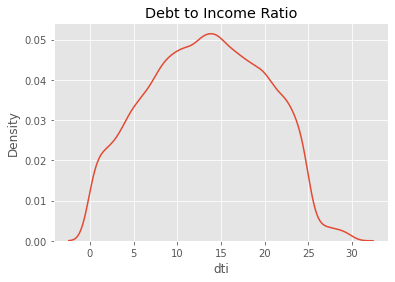

count    38443.000000
mean        13.302011
std          6.659705
min          0.000000
25%          8.170000
50%         13.400000
75%         18.570000
max         29.990000
Name: dti, dtype: float64


In [50]:
plt.figure()
sns.kdeplot(data=df, x="dti")
plt.title("Debt to Income Ratio")
plt.show()
print(df.dti.describe())

**Observation:**
- Most Loans are granted to borrowers who have dti less than 15

### Checking Loan Issued Year

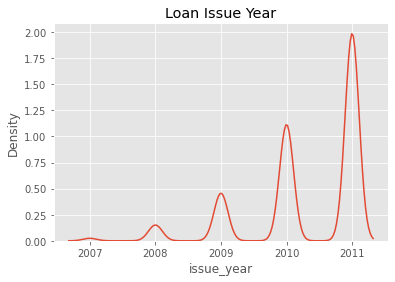

In [51]:
plt.figure()
sns.kdeplot(data=df, x="issue_year")
plt.title("Loan Issue Year")
plt.show()

**Observation:**
- Most Loans are granted in the Year 2011
- A Linear increase of no. of Loans granted as the year goes by

### Checking Loan Issued Month

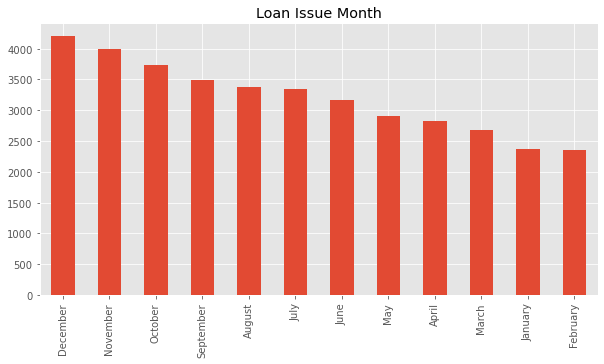

In [52]:
plt.figure()
df.issue_month.value_counts().plot(kind='bar',title='Loan Issue Month', figsize=(10,5))
plt.show()

**Observation:**
- Maximum number of loans are granted at the calendar year end
- A Linear increase of no. of loans granted is observered as the months pass on the calendar year

### Checking Fund released for the Loan by Investor

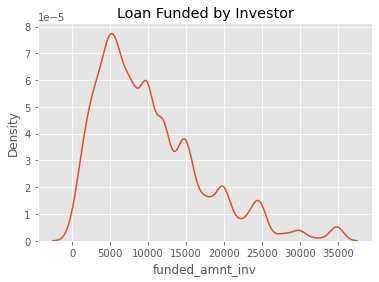

In [53]:
plt.figure()
sns.kdeplot(data=df, x="funded_amnt_inv")
plt.title("Loan Funded by Investor")
plt.show()


In [54]:
print(df.funded_amnt_inv.describe())

count    38443.000000
mean     10203.930649
std       6998.662265
min          0.000000
25%       5000.000000
50%       8700.000000
75%      14000.000000
max      35000.000000
Name: funded_amnt_inv, dtype: float64


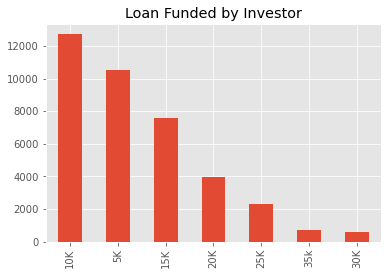

In [55]:
df.funded_amnt_cat.value_counts().plot(kind='bar',title='Loan Funded by Investor')
plt.show()

**Observation:**
- Maximum number of loans are granted in the range of 5000 to 10000

### Checking State which the borrower belong to

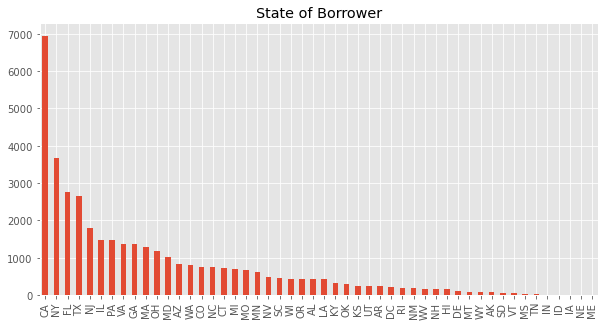

In [56]:
df.addr_state.value_counts().plot(kind='bar',title='State of Borrower', figsize=(10,5))
plt.show()

**Observation:**
- Most Loans are granted to borrowers belonging to California state

### Checking Grade of the Loan

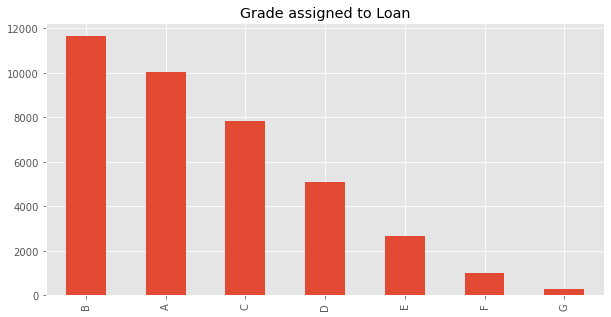

In [57]:
df.grade.value_counts().plot(kind='bar',title='Grade assigned to Loan', figsize=(10,5))
plt.show()

**Observation:**
- Most Loans are granted to Grade B loans

### Checking Sub Grade of the Loan

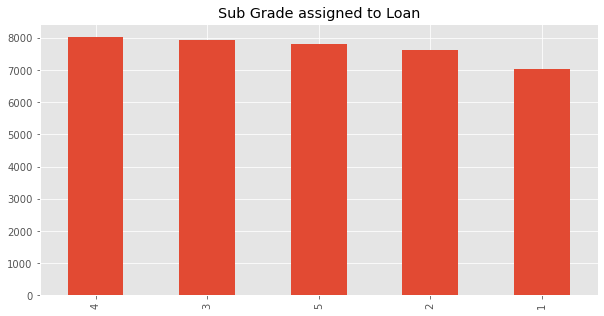

In [58]:
df.sub_grade_cat.value_counts().plot(kind='bar',title='Sub Grade assigned to Loan', figsize=(10,5))
plt.show()

**Observation:**
- Most Loans are granted to Sub-Grade 4

### Checking Purpose of Loan

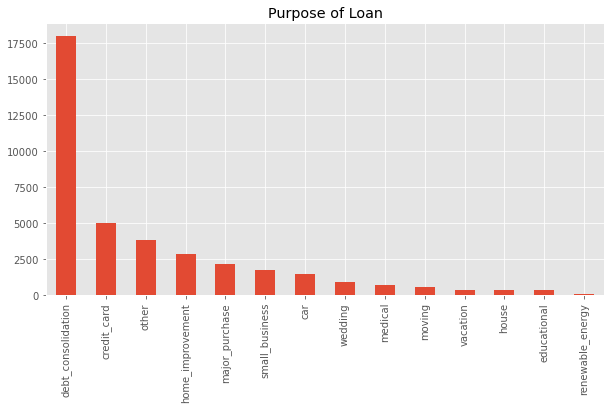

In [59]:
df.purpose.value_counts().plot(kind='bar',title='Purpose of Loan', figsize=(10,5))
plt.show()

**Observation:**
- Most loans are granted for borrowers who need to consolidate several loans into one loan.

## Bivariate and Multivariate Analysis

### Checking Home Ownership and Loan Status

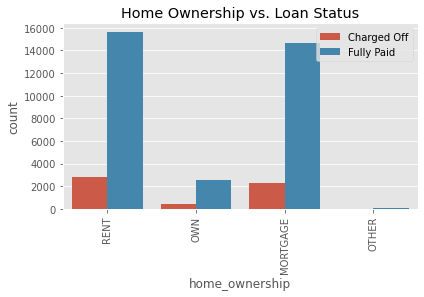

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
3,OTHER,18.556701,0.252322,0.320913,0.79,N,Y
0,RENT,15.362932,47.985329,50.525940,0.95,N,Y
1,OWN,14.839798,7.712718,7.844536,0.98,N,Y
2,MORTGAGE,13.682532,44.049632,41.308611,1.07,Y,N


In [60]:
plt.figure()
sns.countplot(x=df["home_ownership"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Home Ownership vs. Loan Status")
plt.legend(['Charged Off','Fully Paid'])
plt.show()
find_percentage(df,'home_ownership')

**Observation:**
- Home Owners with own houses seem to be in lowest risk category of default

### Checking Home Ownership by Loan Status in terms of Loan Amount

In [61]:
tr0 = go.Box(
    y=df_paid['loan_amnt'],
    x=df_paid["home_ownership"],
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default['loan_amnt'],
    x=df_default['home_ownership'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Home Ownership by Loan Amount'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

**Observation:**
- Home Owners with Mortgage default the high value loans

### Checking Home Ownership by Charge Off Value in terms of Debt to Income Ratio
- High Value Loan is assumed to be Loan amount in top 20% by value

In [62]:
from plotly import subplots
import numpy as np
import plotly.graph_objs as go
high_val_loan=np.quantile(df.funded_amnt_inv,0.8)
df_default_high_val=df_default[df_default.funded_amnt_inv>high_val_loan]
df_default_normal_val=df_default[df_default.funded_amnt_inv<=high_val_loan]
count_normal = go.Bar(
    x = df_default_normal_val.home_ownership.value_counts().index.values,
    y = df_default_normal_val.home_ownership.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.home_ownership.value_counts().index.values,
    y = df_default_high_val.home_ownership.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.home_ownership,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.home_ownership,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)

data = [box_1, box_2, count_normal, count_high]

fig = subplots.make_subplots(rows=1, cols=2,
                          subplot_titles=('Count Charge Off by Home Ownership','Debt to Income by Home Ownership'                                         
                                         ))

fig.append_trace(count_normal, 1, 1)
fig.append_trace(count_high, 1, 1)


fig.append_trace(box_1, 1, 2)
fig.append_trace(box_2, 1, 2)
fig.update_xaxes(title='Home Ownership')
fig['layout'].update(height=400, width=900,title='Home Ownership vs Debt to Income', boxmode='group')
fig['layout']['yaxis'].update(title='Count of Charged Off')
fig['layout']['yaxis2'].update(title='DTI')
py.iplot(fig)

**Observation:**
- Above 30% of the loan default of Mortgage home owners are high value loans
- Home Owners with Own home even when not in mortgage if debt to income ratio is higher then high value loans are defaulted. Hence it is recommended for DTI

### Checking Income Category by Loan Amount in terms of Loan Status

In [63]:
count_paid = go.Bar(
    x = df_paid.income_category.value_counts().index.values,
    y = df_paid.income_category.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.income_category.value_counts().index.values,
    y = df_default.income_category.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid['loan_amnt'],
    x=df_paid.income_category,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default['loan_amnt'],
    x=df_default['income_category'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.income_category.value_counts().index.values,
    y = df_default_normal_val.income_category.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.income_category.value_counts().index.values,
    y = df_default_high_val.income_category.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.income_category,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.income_category,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)

count_default_verified = go.Bar(
    x = df_default[df_default.verification_status_b==1].income_category.value_counts().index.values,
    y = df_default[df_default.verification_status_b==1].income_category.value_counts().values,
    name='Income Verified'
)
count_default_not_verified = go.Bar(
     x = df_default[df_default.verification_status_b==0].income_category.value_counts().index.values,
    y = df_default[df_default.verification_status_b==0].income_category.value_counts().values,
    name='Income Not Verified'
)

box_ver = go.Box(
    x=df_default[df_default.verification_status_b==1].income_category,
    y=df_default[df_default.verification_status_b==1].dti,
    name='Income Verified'
)
box_not_ver = go.Box(
    x=df_default[df_default.verification_status_b==0].income_category,
    y=df_default[df_default.verification_status_b==0].dti,
    name='Income Not Verified'
)

data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2,count_default_verified,count_default_not_verified,box_ver,box_not_ver]

fig = subplots.make_subplots(rows=3, cols=2,
                          subplot_titles=('Count of Loan by Income Category','Loan Amount by Income Category', 
                                          'Count of Charge Off by Income Category','Debt to Income by Income Category',
                                          'Default by Income Category on Verification', 'Default by DTI on Verification'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 1, 2)
fig.append_trace(tr1, 1, 2)

fig.append_trace(count_normal,2,1)
fig.append_trace(count_high,2,1)

fig.append_trace(box_1,2,2)
fig.append_trace(box_2,2,2)

fig.append_trace(count_default_verified,3,1)
fig.append_trace(count_default_not_verified,3,1)

fig.append_trace(box_ver,3,2)
fig.append_trace(box_not_ver,3,2)

fig['layout'].update(height=1000, width=1000, title='Income Category vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Income Group')
fig['layout']['yaxis'].update(title='Count of Loan')


fig['layout']['xaxis2'].update(title='Income Group')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Income Group')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Income Group')
fig['layout']['yaxis4'].update(title='DTI')

fig['layout']['xaxis5'].update(title='Income Group')
fig['layout']['yaxis5'].update(title='Count of Income Verification')

fig['layout']['xaxis6'].update(title='Income Group')
fig['layout']['yaxis6'].update(title='DTI')

py.iplot(fig)


**Observation:**
- Low Income group has the most number of default
- Poor Income group has the highest ratio of default to paid and comes into the high risk category
- Poor Income and Low Income group has the highest ratio of Income Verification(Not Verified) to default
- Middle Income group has defaulted maximum number of High value loans
- DTI above 20 has only default on high value loans which makes it very risky category

### Checking the overall distribution of Loan Amount by Income Category in terms of Loan Status

In [64]:
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_default.income_category,
            "y": df_default.loan_amnt,
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'red'
            }
        },
        {
            "type": 'violin',
            "x": df_paid.income_category,
            "y": df_paid.loan_amnt,
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

**Observation:**
- In terms of Loan value Middle Income group seems to be defaulting in most high value loans

### Checking Employment Length Vs Loan Status

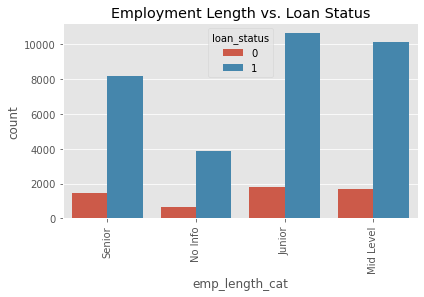

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
0,Senior,15.345613,25.138517,26.439651,0.95,N,Y
2,Junior,14.447297,32.427230,32.109110,1.01,Y,N
3,Mid Level,14.278460,30.733814,30.076663,1.02,Y,N
1,No Info,14.184082,11.700440,11.374577,1.03,Y,N


In [65]:
plt.figure()
sns.countplot(x=df["emp_length_cat"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Employment Length vs. Loan Status")
plt.show()
find_percentage(df,'emp_length_cat')

**Observation:**
- Junior employees have most loans defaulted

### Checking Employment Category vs Loan Amount, Charge-Off Count, DTI by Loan Status

In [66]:
count_paid = go.Bar(
    x = df_paid.emp_length_cat.value_counts().index.values,
    y = df_paid.emp_length_cat.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.emp_length_cat.value_counts().index.values,
    y = df_default.emp_length_cat.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid.loan_amnt,
    x=df_paid.emp_length_cat,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default.loan_amnt,
    x=df_default.emp_length_cat,
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.emp_length_cat.value_counts().index.values,
    y = df_default_normal_val.emp_length_cat.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.emp_length_cat.value_counts().index.values,
    y = df_default_high_val.emp_length_cat.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.emp_length_cat,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.emp_length_cat,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)

count_default_verified = go.Bar(
    x = df_default[df_default.verification_status_b==1].emp_length_cat.value_counts().index.values,
    y = df_default[df_default.verification_status_b==1].emp_length_cat.value_counts().values,
    name='Income Verified'
)
count_default_not_verified = go.Bar(
     x = df_default[df_default.verification_status_b==0].emp_length_cat.value_counts().index.values,
    y = df_default[df_default.verification_status_b==0].emp_length_cat.value_counts().values,
    name='Income Not Verified'
)

box_ver = go.Box(
    x=df_default[df_default.verification_status_b==1].emp_length_cat,
    y=df_default[df_default.verification_status_b==1].dti,
    name='Income Verified'
)
box_not_ver = go.Box(
    x=df_default[df_default.verification_status_b==0].emp_length_cat,
    y=df_default[df_default.verification_status_b==0].dti,
    name='Income Not Verified'
)

data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2,count_default_verified,count_default_not_verified,box_ver,box_not_ver]


fig = subplots.make_subplots(rows=3, cols=2,
                          subplot_titles=('Loan Count by Emp Category','Loan Amount by Emp Category', 
                                          'Charge-Off by Emp Category', 'Debt to Income by Emp Category',
                                         'Default by Emp Category on Verification', 'Default by DTI on Verification'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 1, 2)
fig.append_trace(tr1, 1, 2)

fig.append_trace(count_normal, 2, 1)
fig.append_trace(count_high, 2, 1)

fig.append_trace(box_1, 2, 2)
fig.append_trace(box_2, 2, 2)

fig.append_trace(count_default_verified, 3, 1)
fig.append_trace(count_default_not_verified,3, 1)

fig.append_trace(box_ver, 3, 2)
fig.append_trace(box_not_ver, 3, 2)

fig['layout'].update(height=1000, width=1000, title='Emp Category vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Emp Category')
fig['layout']['yaxis'].update(title='Count of Loan')

fig['layout']['xaxis2'].update(title='Emp Category')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Emp Category')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Emp Category')
fig['layout']['yaxis4'].update(title='DTI')

fig['layout']['xaxis5'].update(title='Emp Category')
fig['layout']['yaxis5'].update(title='Count of Income Verification')

fig['layout']['xaxis6'].update(title='Emp Category')
fig['layout']['yaxis6'].update(title='DTI')

py.iplot(fig)

**Observation:**
- Senior employees with experience above 9 years has high default to paid ratio as well as most default in high value loans.
- Junior employees with less than 3 years of experience with No Income verification tend default more loans

### Checking Verifications Status vs Loan Status

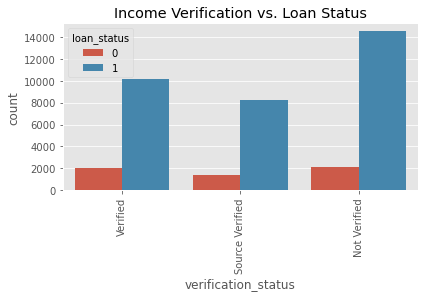

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
0,Verified,16.811904,31.641651,36.459262,0.87,N,Y
1,Source Verified,14.837504,25.052675,25.476912,0.98,N,Y
2,Not Verified,12.824363,43.305673,38.063826,1.14,Y,N


In [67]:
plt.figure()
sns.countplot(x=df["verification_status"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Income Verification vs. Loan Status")
plt.show()
find_percentage(df,'verification_status')

**Observation:**
- Income Not Verified category has the most number of default by contributing 43.3% of defaults in verification status category.
- Eventhough Not Verified loans are 38% but 43% of the default loans from this category hence Not Verified is a high risk

In [68]:
tr0 = go.Box(
    y=df_paid['loan_amnt'],
    x=df_paid["verification_status"],
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default['loan_amnt'],
    x=df_default['verification_status'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Income Verification'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

**Observation:**
- Verified Income category has defaulted the most high value loans 

### Checking Verification Status vs Interest Rate by Loan Status

In [69]:
tr0 = go.Box(
    y=df_paid['int_rate'],
    x=df_paid["verification_status"],
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default['int_rate'],
    x=df_default['verification_status'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Interest Rate',
        zeroline=False
    ),
    xaxis=dict(
        title='Income Verification'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

**Observation:**
- Verification status has no impact on default due to high interest rate

### Checking Purpose vs Loan Status

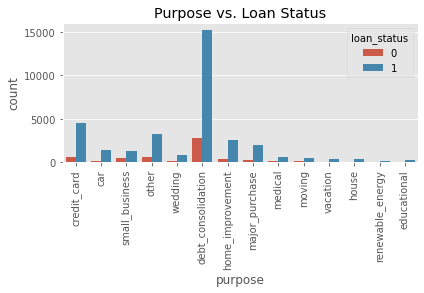

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
2,small_business,27.090493,4.541789,8.432876,0.54,N,Y
12,renewable_energy,19.000000,0.260125,0.338741,0.77,N,Y
13,educational,17.283951,0.842806,0.998395,0.84,N,Y
3,other,16.346653,10.025232,11.231949,0.89,N,Y
11,house,16.208791,0.946856,1.051881,0.90,N,Y
9,moving,15.909091,1.487917,1.622393,0.92,N,Y
8,medical,15.634218,1.763650,1.889820,0.93,N,Y
5,debt_consolidation,15.343181,46.843379,49.260118,0.95,N,Y
10,vacation,14.133333,0.975470,0.944910,1.03,Y,N
6,home_improvement,12.029546,7.395365,6.097344,1.21,Y,N


In [70]:
plt.figure()
sns.countplot(x=df["purpose"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Purpose vs. Loan Status")
plt.show()
find_percentage(df,'purpose')

**Observation:**
- Debt Consolidation is the most defaulted purpose of loan
- Loans obtained for Small Business has very high chance of default
- Credit Card Loans are 9% of Purpose category but 13% of the overall default.

### Checking Purpose vs Loan Amount by Loan Status

In [71]:
tr0 = go.Box(
    y=df_paid['loan_amnt'],
    x=df_paid["purpose"],
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default['loan_amnt'],
    x=df_default['purpose'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Purpose'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

**Observation:**
- Small business is the category in Purpose which defaults in highest loan value next to Debt Consolidation and Credit Card

In [72]:
count_paid = go.Bar(
    x = df_paid.purpose.value_counts().index.values,
    y = df_paid.purpose.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.purpose.value_counts().index.values,
    y = df_default.purpose.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid.loan_amnt,
    x=df_paid.purpose,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default.loan_amnt,
    x=df_default.purpose,
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.purpose.value_counts().index.values,
    y = df_default_normal_val.purpose.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.purpose.value_counts().index.values,
    y = df_default_high_val.purpose.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.purpose,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.purpose,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)


data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2]

fig = subplots.make_subplots(rows=4, cols=1,
                          subplot_titles=('Loan Count by Purpose','Loan Amount by Purpose', 
                                          'Charge-Off by Purpose', 'Debt to Income by Purpose'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 2, 1)
fig.append_trace(tr1, 2, 1)

fig.append_trace(count_normal, 3, 1)
fig.append_trace(count_high, 3, 1)

fig.append_trace(box_1, 4, 1)
fig.append_trace(box_2, 4, 1)

fig['layout'].update(height=1400, width=900, title='Purpose vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Purpose')
fig['layout']['yaxis'].update(title='Count of Loan')

fig['layout']['xaxis2'].update(title='Purpose')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Purpose')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Purpose')
fig['layout']['yaxis4'].update(title='DTI')



py.iplot(fig)

**Observation:**
- Credit card, Debt consolidation and small business have maximum high value loan charge-off above DTI 15 hence it is risky range for the category.

### Checking Term Vs Loan Status

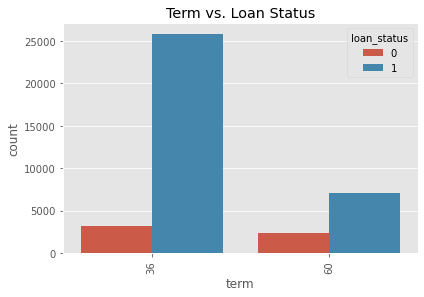

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
1,60.0,25.333474,24.571443,42.663576,0.58,N,Y
0,36.0,11.090802,75.428557,57.336424,1.32,Y,N


In [73]:
plt.figure()
sns.countplot(x=df["term"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Term vs. Loan Status")
plt.show()
find_percentage(df,'term')

**Observation**
- Most loans obtained with a term of 36 months
- 75% defaulted loans are from 36 months term which is much greater than Loans Obtained which is at 57%
- 25% of 60 months tenure loans are defaulted which makes it a very high risk category

### Checking Term vs Loan Amount, Charge Off, DTI by Loan Status

In [74]:
count_paid = go.Bar(
    x = df_paid.term.value_counts().index.values,
    y = df_paid.term.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.term.value_counts().index.values,
    y = df_default.term.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid.loan_amnt,
    x=df_paid.term,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default.loan_amnt,
    x=df_default.term,
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.term.value_counts().index.values,
    y = df_default_normal_val.term.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.term.value_counts().index.values,
    y = df_default_high_val.term.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.term,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.term,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)


data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2]

fig = subplots.make_subplots(rows=2, cols=2,
                          subplot_titles=('Loan Count by Term','Loan Amount by Term', 
                                          'Charge-Off by Term', 'Debt to Income by Term'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 1, 2)
fig.append_trace(tr1, 1, 2)

fig.append_trace(count_normal, 2, 1)
fig.append_trace(count_high, 2, 1)

fig.append_trace(box_1, 2, 2)
fig.append_trace(box_2, 2, 2)

fig['layout'].update(height=800, width=900, title='Term vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Term')
fig['layout']['yaxis'].update(title='Count of Loan')

fig['layout']['xaxis2'].update(title='Term')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Term')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Term')
fig['layout']['yaxis4'].update(title='DTI')



py.iplot(fig)

**Observation:**
- Most of the 36 month term loans are less than 10K loan amount
- Most of the 60 month term loans are above 10K loan amount
- Around 40% of default in 60 month term is High value.
- Debt to Income above 15 for 60 month term is very risk category considering 25% of this category is defaulted.

### Checking Loan Grade vs Loan Status

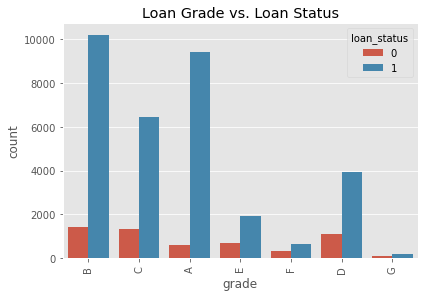

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
6,G,34.013605,0.764769,1.782849,0.43,N,Y
4,F,32.613169,2.528419,5.651631,0.45,N,Y
3,E,26.832955,6.882918,12.658228,0.54,N,Y
5,D,22.007494,13.190958,19.896595,0.66,N,Y
1,C,17.219731,20.302786,23.961490,0.85,N,Y
0,B,12.203506,30.268189,25.316456,1.20,Y,N
2,A,6.008584,26.061962,10.732751,2.43,Y,N


In [75]:
plt.figure()
sns.countplot(x=df["grade"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Loan Grade vs. Loan Status")
plt.show()
find_percentage(df,'grade')

**Observation:**
- Grade B is the Loan Grade of most loans granted.

### Checking Grade vs Loan Amount, Charge Off, DTI by Loan Status

In [76]:
count_paid = go.Bar(
    x = df_paid.grade.value_counts().index.values,
    y = df_paid.grade.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.grade.value_counts().index.values,
    y = df_default.grade.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid.loan_amnt,
    x=df_paid.grade,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default.loan_amnt,
    x=df_default.grade,
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.grade.value_counts().index.values,
    y = df_default_normal_val.grade.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.grade.value_counts().index.values,
    y = df_default_high_val.grade.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.grade,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.grade,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)


data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2]

fig = subplots.make_subplots(rows=2, cols=2,
                          subplot_titles=('Loan Count by Grade','Loan Amount by Grade', 
                                          'Charge-Off by Grade', 'Debt to Income by Grade'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 1, 2)
fig.append_trace(tr1, 1, 2)

fig.append_trace(count_normal, 2, 1)
fig.append_trace(count_high, 2, 1)

fig.append_trace(box_1, 2, 2)
fig.append_trace(box_2, 2, 2)

fig['layout'].update(height=800, width=900, title='Grade vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Grade')
fig['layout']['yaxis'].update(title='Count of Loan')

fig['layout']['xaxis2'].update(title='Grade')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Grade')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Grade')
fig['layout']['yaxis4'].update(title='DTI')



py.iplot(fig)

**Observations:**
- Most of the Loan granted in categories E, F and G are above 10K
- Grade E,F,G categories default the most in High value loans
- Debt to Income ratio above 15 for Grade E,F,G loans is very risky category

### Checking Loan Sub Grade vs Loan Status

In [77]:
find_percentage(df,'sub_grade_cat')

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
0,2.0,15.114143,19.826756,20.538420,0.97,N,Y
2,5.0,14.844649,20.344406,20.698877,0.98,N,Y
3,1.0,14.556331,18.263403,18.220717,1.00,Y,N
4,3.0,14.506989,20.656556,20.538420,1.01,Y,N
1,4.0,13.958696,20.908878,20.003566,1.05,Y,N


### Checking Sub Grade vs Loan Amount, Charge Off, DTI by Loan Status

In [78]:
count_paid = go.Bar(
    x = df_paid.sub_grade_cat.value_counts().index.values,
    y = df_paid.sub_grade_cat.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.sub_grade_cat.value_counts().index.values,
    y = df_default.sub_grade_cat.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid.loan_amnt,
    x=df_paid.sub_grade_cat,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default.loan_amnt,
    x=df_default.sub_grade_cat,
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.sub_grade_cat.value_counts().index.values,
    y = df_default_normal_val.sub_grade_cat.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.sub_grade_cat.value_counts().index.values,
    y = df_default_high_val.sub_grade_cat.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.sub_grade_cat,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.sub_grade_cat,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)


data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2]

fig = subplots.make_subplots(rows=2, cols=2,
                          subplot_titles=('Loan Count by Sub Grade','Loan Amount by Sub Grade', 
                                          'Charge-Off by Sub Grade', 'Debt to Income by Sub Grade'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 1, 2)
fig.append_trace(tr1, 1, 2)

fig.append_trace(count_normal, 2, 1)
fig.append_trace(count_high, 2, 1)

fig.append_trace(box_1, 2, 2)
fig.append_trace(box_2, 2, 2)

fig['layout'].update(height=800, width=1000, title='Sub Grade vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Sub Grade')
fig['layout']['yaxis'].update(title='Count of Loan')

fig['layout']['xaxis2'].update(title='Sub Grade')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Sub Grade')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Sub Grade')
fig['layout']['yaxis4'].update(title='DTI')



py.iplot(fig)

**Observation:**
- Sub Grade 5 has the maximum no. of high value loans defaulted

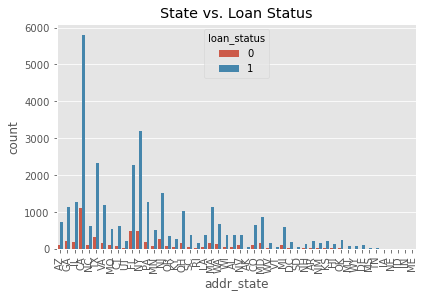

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
46,NE,60.000000,0.013006,0.053485,0.24,N,Y
25,NV,22.431866,1.240798,1.907648,0.65,N,Y
33,SD,19.354839,0.161278,0.213942,0.75,N,Y
26,AK,18.181818,0.200297,0.249599,0.80,N,Y
10,FL,18.027457,7.200271,8.896416,0.81,N,Y
7,MO,17.040359,1.740239,2.032448,0.86,N,Y
38,HI,16.867470,0.431808,0.499198,0.87,N,Y
47,ID,16.666667,0.015608,0.017828,0.88,N,Y
36,NM,16.574586,0.470827,0.534855,0.88,N,Y
15,OR,16.321839,1.131545,1.265823,0.89,N,Y


In [79]:
plt.figure()
sns.countplot(x=df["addr_state"], hue=df["loan_status"])
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("State vs. Loan Status")
plt.show()
find_percentage(df,'addr_state')

**Observation:**
- Most loans are granted to borrowers in California state

### Checking Loan Issued Month vs Loan Status

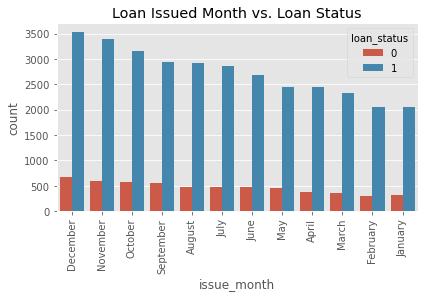

,Value,% of Charge-Off,% Of Contribution,% of Loan Obtained,Default to Loan Ratio,% Charge-Off > % Loan Obtained,% Charge-Off > Avg Charge Off
0,December,16.087577,10.930468,12.052059,0.91,N,Y
7,May,15.916122,7.567047,8.254591,0.92,N,Y
3,September,15.671642,9.062768,9.734356,0.93,N,Y
2,October,15.413433,9.720885,10.269210,0.95,N,Y
6,June,15.192672,8.235570,8.575504,0.96,N,Y
1,November,14.951165,10.386806,10.643608,0.98,N,Y
5,July,14.255828,8.703795,8.504190,1.02,Y,N
4,August,13.820657,8.789637,8.325905,1.06,Y,N
11,January,13.482671,6.154567,5.687288,1.08,Y,N
8,April,13.101983,7.345941,6.596541,1.11,Y,N


In [80]:
plt.figure()
sns.countplot(x=df.issue_month, hue=df.loan_status)
plt.xticks(rotation=90)
plt.tight_layout()
plt.title("Loan Issued Month vs. Loan Status")
plt.show()
find_percentage(df,'issue_month')

**Observation:**
- Loans issued in first quarter of the year has high default to loan ratio

### Checking Loan Issued Month vs Loan Amount, Charge Off, DTI by Loan Status

In [81]:
count_paid = go.Bar(
    x = df_paid.issue_month.value_counts().index.values,
    y = df_paid.issue_month.value_counts().values,
    name='Fully Paid'
)

count_default = go.Bar(
    x = df_default.issue_month.value_counts().index.values,
    y = df_default.issue_month.value_counts().values,
    name='Charged Off'
)

tr0 = go.Box(
    y=df_paid.loan_amnt,
    x=df_paid.issue_month,
    name='Fully Paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_default.loan_amnt,
    x=df_default.issue_month,
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)

count_normal = go.Bar(
    x = df_default_normal_val.issue_month.value_counts().index.values,
    y = df_default_normal_val.issue_month.value_counts().values,
    name='Charge Off'
)
count_high = go.Bar(
    x = df_default_high_val.issue_month.value_counts().index.values,
    y = df_default_high_val.issue_month.value_counts().values,
    name='High Value Charge Off'
)


box_1 = go.Box(
    x=df_default_normal_val.issue_month,
    y=df_default_normal_val.dti,
    name='Charge Off'
)
box_2 = go.Box(
    x=df_default_high_val.issue_month,
    y=df_default_high_val.dti,
    name='High Value Charge Off'
)


data = [tr0, tr1, count_paid, count_default,count_normal,count_high,box_1,box_2]

fig = subplots.make_subplots(rows=4, cols=1,
                          subplot_titles=('Loan Count by Loan Issued Month','Loan Amount by Loan Issued Month', 
                                          'Charge-Off by Loan Issued Month', 'Debt to Income by Loan Issued Month'
                                         ))

fig.append_trace(count_paid, 1, 1)
fig.append_trace(count_default, 1, 1)

fig.append_trace(tr0, 2, 1)
fig.append_trace(tr1, 2, 1)

fig.append_trace(count_normal, 3, 1)
fig.append_trace(count_high, 3, 1)

fig.append_trace(box_1, 4, 1)
fig.append_trace(box_2, 4, 1)

fig['layout'].update(height=1400, width=1050, title='Loan Issued Month vs Loan Amount by Loan Status', boxmode='group')

fig['layout']['xaxis'].update(title='Loan Issued Month')
fig['layout']['yaxis'].update(title='Count of Loan')

fig['layout']['xaxis2'].update(title='Loan Issued Month')
fig['layout']['yaxis2'].update(title='Loan Amount')

fig['layout']['xaxis3'].update(title='Loan Issued Month')
fig['layout']['yaxis3'].update(title='Count of Charge-Off')

fig['layout']['xaxis4'].update(title='Loan Issued Month')
fig['layout']['yaxis4'].update(title='DTI')



py.iplot(fig)

**Observation:**
- Most Loans with high value default are granted in the last quarter of the calendar year

---

## Recommendations
- Debt to Income Ratio is major driver for default and above 20 has very high value loans charged off hence it is recommended to not to grant loans above dti ratio of 20.
- Home Owners with Mortgage default the high value loans with are around 30% of charge-off comprises of high value. Hence it is recommended to reduce the funded amount by investor to the requested loan amount.
- Low Income Group has most number of default and Poor Income group has the highest ratio of default to paid with DTI to default observation of very high default above 15 hence it is recommended to grant loans with debt to income ratio of less than 15 and whose income is not verified to Low and Middle income group to reduce default.
- Employees with less than 3 years of experience who has verified Income to be granted loans since this category has most number of default.
- Credit card, Debt consolidation and small business purposes to granted loans of DTI less than 15 since above that ratio very high value loans are defaulted.
- Borrowers with DTI less than 15 to be granted of 60 month term loans since above that there is very high default with overall defaul percentage of 25% for this term.
- Grade E,F,G categories default the most in High value loans and dti above 15 has very high default ratio hence it is recommended to grant only to dti less than 15 and whose income is verified.